# embedding topology analysis

Use the observed loop/parallel trajectories in smooth muscle of gut_dev_Huycke dataset.  

In [1]:
%load_ext autoreload
%autoreload 2

# Basic setup

In [2]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import time
from pathlib import Path
import torch
import concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import matplotlib as mpl
from scipy import sparse

from matplotlib import font_manager, rcParams
custom_rc = {
    'font.family': 'DejaVu Sans',
}

mpl.rcParams['svg.fonttype'] = 'none'
mpl.rcParams['pdf.fonttype'] = 42

In [ ]:
proj_name = "gut_dev_Huycke"
file_name = "gut_dev_Huycke_Jul17-1902"
file_suffix = time.strftime('%b%d-%H%M')

save_dir = Path(f"../save/{proj_name}-{file_suffix}")
save_dir.mkdir(parents=True, exist_ok=True)

data_dir = Path(f"../data/{proj_name}")
data_dir.mkdir(parents=True, exist_ok=True)

seed = 0
ccd.ul.set_seed(seed)

In [7]:
# load the data
adata = sc.read_h5ad(data_dir / f"{file_name}_final.h5ad")

In [8]:
# Define color palette for broad_cell_type
_, _, celltype_pal = ccd.pl.get_color_mapping(adata, 'cell_type', pal='Set1', seed=seed)
_, _, broad_celltype_pal = ccd.pl.get_color_mapping(adata, 'broad_cell_type', pal='Set1', seed=seed)
_, _, phase_pal = ccd.pl.get_color_mapping(adata, 'phase', pal='Set1', seed=seed)

pal = {"cell_type": celltype_pal,
    "broad_cell_type": broad_celltype_pal,
    'phase': phase_pal,}

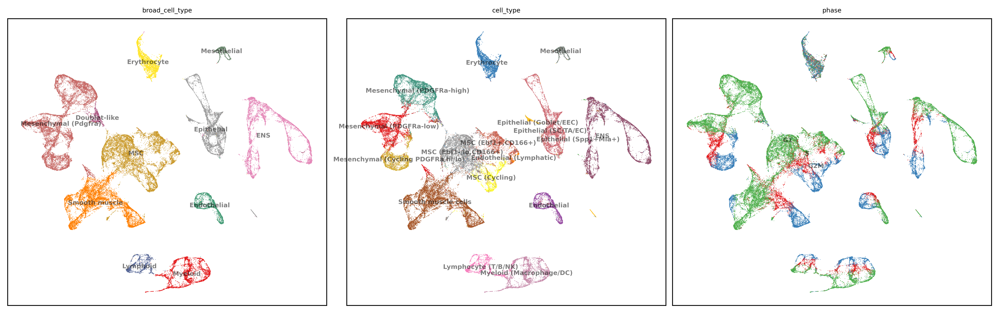

In [8]:
# basis = 'concord_hcl'
basis = 'concord_knn'
show_basis = basis + '_UMAP'
show_cols = ['broad_cell_type', 'cell_type', 'phase']
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=6, point_size=1, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_embedding.pdf"
)

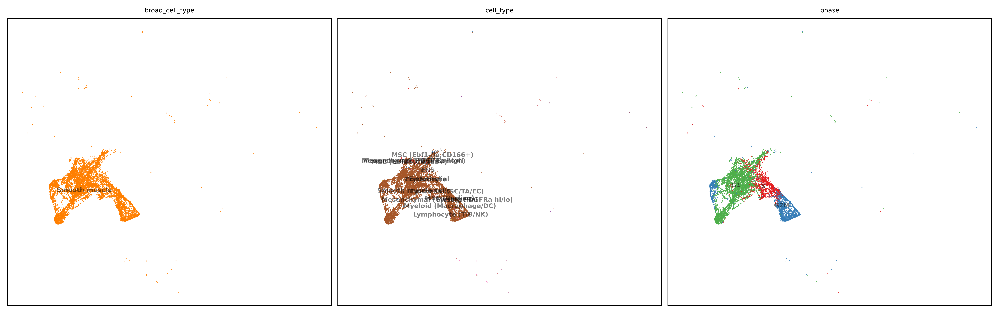

In [9]:
# plot UMAP of the cell subset in the concord_knn embedding
cell_type_subset = 'Smooth muscle'
adata_subset = adata[adata.obs['broad_cell_type'] == cell_type_subset].copy()
basis = 'concord_knn'
show_basis = basis + '_UMAP'
show_cols = ['broad_cell_type', 'cell_type', 'phase']       
ccd.pl.plot_embedding(
    adata_subset, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=6, point_size=3, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_embedding.pdf"
)

In [10]:
color_by = 'phase'

ccd.pl.plot_embedding_3d(
    adata_subset, basis='concord_knn_UMAP_3D', color_by=color_by,
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_{color_by}_embedding_3d.html",
    point_size=1, opacity=0.7,
)

concord.plotting.pl_embedding - INFO - 3D plot saved to ../save/gut_dev_Huycke-Aug08-0055/gut_dev_Huycke_Jul17-1902_concord_knn_UMAP_Smooth muscle_phase_embedding_3d_phase.html


[Figure({
     'data': [{'hovertemplate': 'phase=S<br>DIM1=%{x}<br>DIM2=%{y}<br>DIM3=%{z}<extra></extra>',
               'legendgroup': 'S',
               'marker': {'color': '#e41a1c', 'opacity': 0.7, 'size': 1, 'symbol': 'circle'},
               'mode': 'markers',
               'name': 'S',
               'scene': 'scene',
               'showlegend': True,
               'type': 'scatter3d',
               'x': {'bdata': ('h0psQJutOUFiuzhBW7I+QdoyOkF1dD' ... 'M6QTsJQ0GgIlhBN24+QfmJP0EFaThB'),
                     'dtype': 'f4'},
               'y': {'bdata': ('r02RQBcKxUA2kt1AApqmQHnhvUCafL' ... '/TQNANyECT/7tApL7OQLGozUACUeFA'),
                     'dtype': 'f4'},
               'z': {'bdata': ('n7beQIvYpkAThL9A1VCiQHvPjkB9YY' ... 'rEQDcw00D7neBAliLZQJEqwkCJJepA'),
                     'dtype': 'f4'}},
              {'hovertemplate': 'phase=G1<br>DIM1=%{x}<br>DIM2=%{y}<br>DIM3=%{z}<extra></extra>',
               'legendgroup': 'G1',
               'marker': {'color': '#4daf4a

In [13]:
adata_subset.obsm['concord_knn_UMAP_3D_DIM1&3'] = adata_subset.obsm['concord_knn_UMAP_3D'][:, [0, 2]]

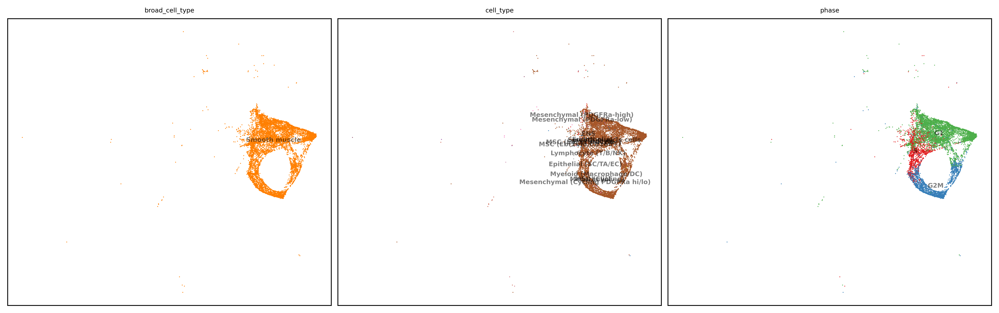

In [14]:
show_basis = 'concord_knn_UMAP_3D_DIM1&3'
show_cols = ['broad_cell_type', 'cell_type', 'phase'] 

ccd.pl.plot_embedding(
    adata_subset, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=6, point_size=3, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_embedding.pdf"
)

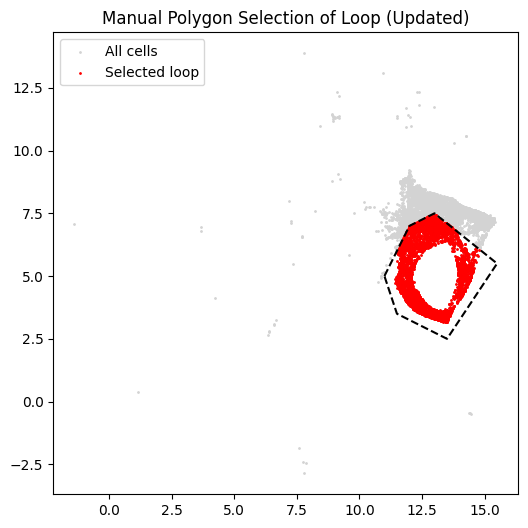

In [76]:
from matplotlib.path import Path
import matplotlib.pyplot as plt
import numpy as np

# Step 1: Coordinates (e.g., UMAP)
X = adata_subset.obsm['concord_knn_UMAP_3D_DIM1&3']

# Step 2: Define updated polygon
polygon = np.array([
    [11.0, 5.0],
    [12.0, 7.0],
    [13.0, 7.5],
    [15.5, 5.5],
    [13.5, 2.5],
    [11.5, 3.5],
    [11.0, 5.0]  # closing the loop
])
path = Path(polygon)

# Step 3: Find points inside polygon
mask = path.contains_points(X)
adata_subset_loop = adata_subset[mask].copy()

# Step 4: Plot result
plt.figure(figsize=(6, 6))
plt.scatter(X[:, 0], X[:, 1], c='lightgray', s=1, label='All cells')
plt.scatter(X[mask, 0], X[mask, 1], c='red', s=1, label='Selected loop')
plt.plot(polygon[:, 0], polygon[:, 1], 'k--')  # draw loop
plt.legend()
plt.title("Manual Polygon Selection of Loop (Updated)")

# save the selected loop figure in the save directory
plt.savefig(save_dir / f"{file_name}_{cell_type_subset}_loop_selection.pdf", bbox_inches='tight', dpi=300)

plt.show()


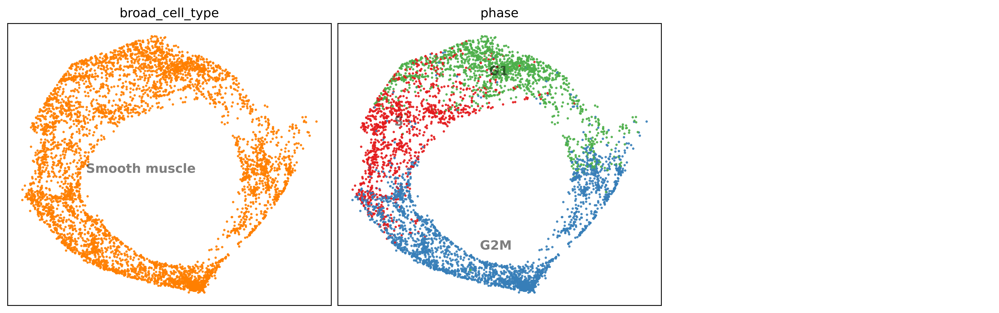

In [9]:
show_basis = 'concord_knn_UMAP_3D_DIM1&3'
show_cols = ['broad_cell_type', 'phase']

ccd.pl.plot_embedding(
    adata_subset_loop, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=12, point_size=20, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_loop_embedding.pdf",
)

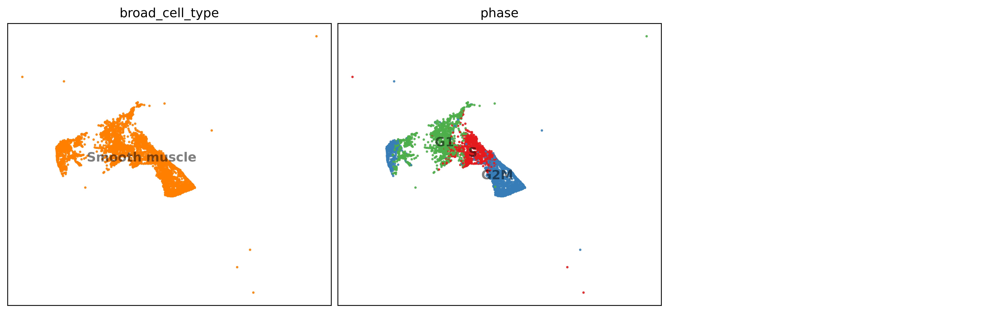

In [10]:
show_basis = 'concord_knn_UMAP'
show_cols = ['broad_cell_type', 'phase']

ccd.pl.plot_embedding(
    adata_subset_loop, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=12, point_size=20, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_loop_embedding.pdf",
)

In [11]:
adata_subset_loop.obs['phase'].value_counts()

phase
G2M    2587
G1     1469
S      1160
Name: count, dtype: int64

----

# (1) leiden clustering

In [12]:
import scanpy as sc

# Step 1: Create a neighbor graph from the latent space you want to use
sc.pp.neighbors(adata_subset_loop, use_rep='concord_knn', n_neighbors=15)

# Step 2: Run Leiden clustering
sc.tl.leiden(adata_subset_loop, resolution=0.2, key_added='leiden_concord_knn')

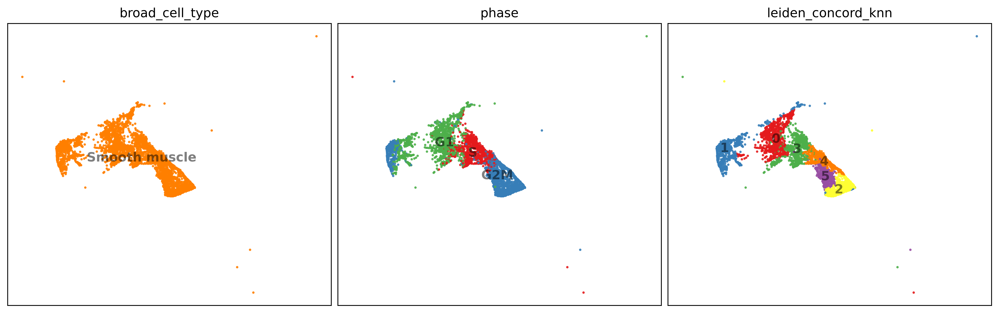

In [13]:
show_basis = 'concord_knn_UMAP'
show_cols = ['broad_cell_type', 'phase', 'leiden_concord_knn']

ccd.pl.plot_embedding(
    adata_subset_loop, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=12, point_size=20, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_loop_leiden_embedding.pdf"
)

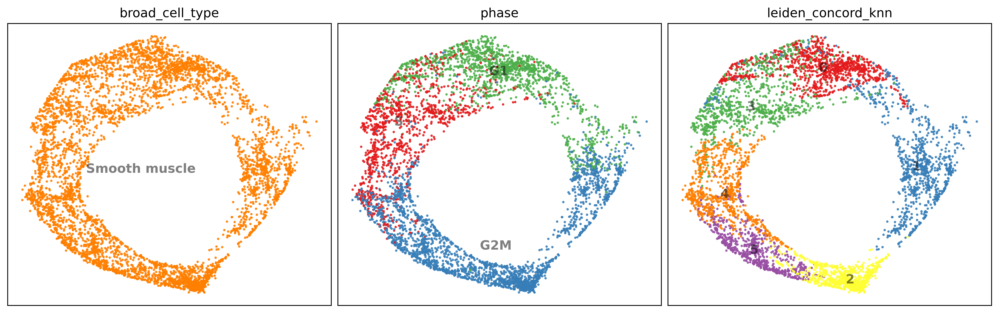

In [14]:
show_basis = 'concord_knn_UMAP_3D_DIM1&3'
show_cols = ['broad_cell_type', 'phase', 'leiden_concord_knn']

ccd.pl.plot_embedding(
    adata_subset_loop, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=12, point_size=20, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_loop_leiden_embedding.pdf"
)

----

# (2) order cells by pseudotime

In [15]:
# UMAP coordinates for loop cells
X_loop = adata_subset_loop.obsm['concord_knn_UMAP_3D_DIM1&3']

# Step 1: Choose a center — either geometric or manual
center = X_loop.mean(axis=0)  # or set manually like np.array([5.5, 3.0])


In [16]:
# Step 1: Define custom mapping
# Replace keys with original Leiden cluster labels and values with desired labels based on loop_order
leiden_loop_map = {
    '0': 'loop1',
    '3': 'loop1',
    '4': 'loop1',
    '5': 'loop1',
    '2': 'loop1',
    '1': 'loop1',
}

leiden_loop_clusters_map = {
    '0': 'loop1-1',
    '3': 'loop1-2',
    '4': 'loop1-3',
    '5': 'loop1-4',
    '2': 'loop1-5',
    '1': 'loop1-6',
    # ... continue as needed
}

# Step 2: Apply the mapping
adata_subset_loop.obs['leiden_loop'] = (
    adata_subset_loop.obs['leiden_concord_knn'].map(leiden_loop_map)
)
adata_subset_loop.obs['leiden_loop_clusters'] = (
    adata_subset_loop.obs['leiden_concord_knn'].map(leiden_loop_clusters_map)
)

# Step 3: Set as categorical with order (optional, for plotting consistency)
custom_order = list(leiden_loop_clusters_map.values())  # ['loop-1', 'loop-2', ...] in your preferred order
adata_subset_loop.obs['leiden_loop_clusters'] = pd.Categorical(
    adata_subset_loop.obs['leiden_loop_clusters'],
    categories=custom_order,
    ordered=True
)

_, _, leiden_loop_pal = ccd.pl.get_color_mapping(adata_subset_loop, 'leiden_loop', pal='Set1', seed=seed)
_, _, leiden_loop_clusters_pal = ccd.pl.get_color_mapping(adata_subset_loop, 'leiden_loop_clusters', pal='Set1', seed=seed)
pal = {"broad_cell_type": broad_celltype_pal,
    'phase': phase_pal,
    'leiden_loop': leiden_loop_pal,
    'leiden_loop_clusters': leiden_loop_clusters_pal}

In [19]:
# order cells by pseudotime

import numpy as np
import pandas as pd

# Step 1: Get UMAP coordinates and loop labels
X_loop = adata_subset_loop.obsm['concord_knn_UMAP_3D_DIM1&3']

# Step 2: Choose center
center = X_loop.mean(axis=0)  # or np.array([x, y])
X_centered = X_loop - center

# Step 3: Compute base angles in radians
angles = np.arctan2(X_centered[:, 1], X_centered[:, 0])  # [-π, π]
angles = (angles + 2 * np.pi) % (2 * np.pi)  # Convert to [0, 2π]

# Step 4: Apply custom angle shift per loop
angle_shifted = angles.copy()
angle_shifted = (angles - np.pi / 3) % (2 * np.pi)

# Step 5: Store in .obs
adata_subset_loop.obs['loop_angle'] = angle_shifted

# Step 6: Order cells by angle (loop-wise)
adata_subset_loop.obs['loop_order'] = (
    angle_shifted.argsort().argsort()  # Gives 0 to N-1 ranking
)

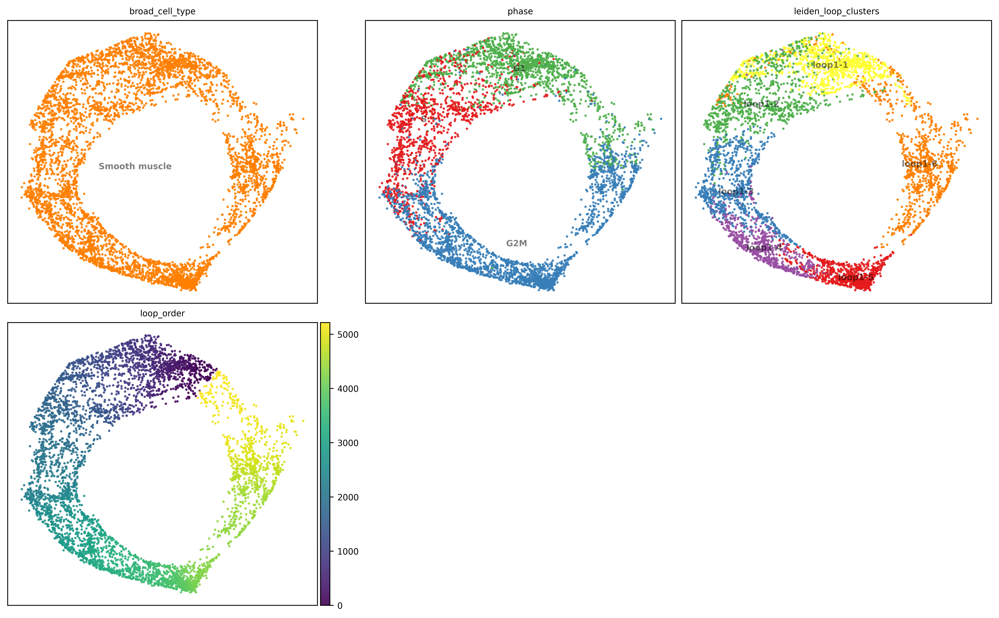

In [26]:
show_basis = 'concord_knn_UMAP_3D_DIM1&3'

ccd.pl.plot_embedding(
    adata_subset_loop, show_basis, 
    color_by = ['broad_cell_type', 'phase', 'leiden_loop_clusters', 'loop_order'] , 
    figsize=(13,8), dpi=600, ncols=3, point_size=20, 
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_loop_ordered_embedding.svg",
)

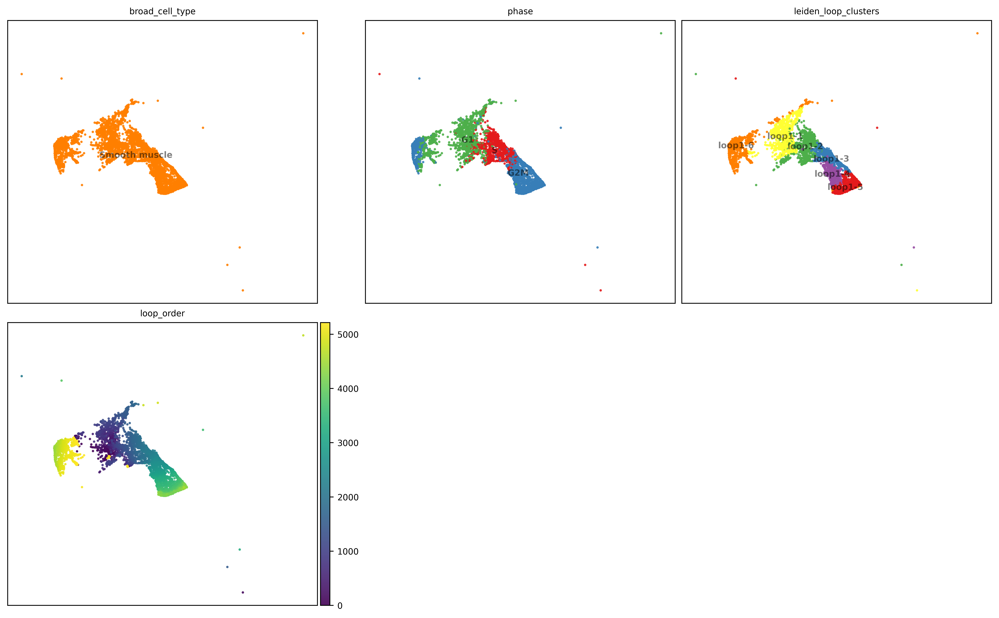

In [25]:
show_basis = 'concord_knn_UMAP'

ccd.pl.plot_embedding(
    adata_subset_loop, show_basis, 
    color_by = ['broad_cell_type', 'phase', 'leiden_loop_clusters', 'loop_order'] , 
    figsize=(13,8), dpi=600, ncols=3, point_size=20, 
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_loop_ordered_embedding.svg",
)

----

In [23]:
import scanpy as sc

sc.tl.rank_genes_groups(
    adata_subset_loop, 
    groupby='leiden_loop_clusters', 
    method='wilcoxon', 
    use_raw=False
)


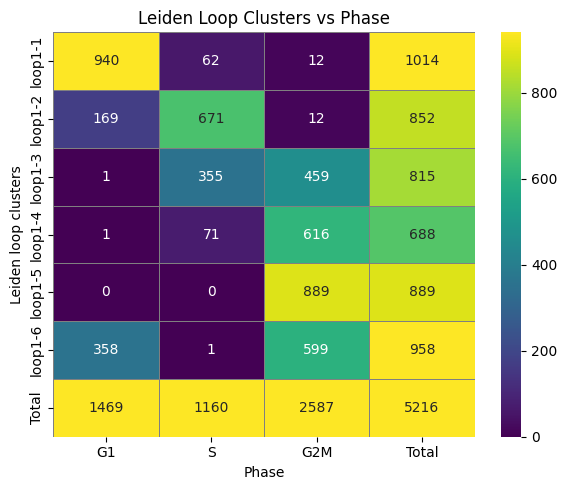

In [29]:
import seaborn as sns, matplotlib.pyplot as plt

phase_order = ['G1', 'S', 'G2M']
adata_subset_loop.obs['phase'] = pd.Categorical(
    adata_subset_loop.obs['phase'], 
    categories=phase_order, 
    ordered=True
)

# Crosstab with totals
crosstab_df = pd.crosstab(
    adata_subset_loop.obs['leiden_loop_clusters'],
    adata_subset_loop.obs['phase'],
    margins=True, margins_name="Total"
)

# Exclude 'Total' row and column for vmax
crosstab_clean = crosstab_df.drop(index="Total", columns="Total")
vmax_val = crosstab_clean.to_numpy().max()

# Plot full table with fixed color scale
plt.figure(figsize=(6, 5))
sns.heatmap(crosstab_df, annot=True, fmt='d', cmap='viridis', cbar=True,
            linewidths=0.5, linecolor='gray', vmin=0, vmax=vmax_val)
plt.title("Leiden Loop Clusters vs Phase")
plt.ylabel("Leiden loop clusters")
plt.xlabel("Phase")
plt.tight_layout()
plt.savefig(save_dir / f"{file_name}_leiden_phase_crosstab.svg", dpi=300)
plt.show()
plt.close()


In [30]:
pal = {"cell_type": celltype_pal,
    "broad_cell_type": broad_celltype_pal,
    'phase': phase_pal,
    'leiden_loop_clusters': leiden_loop_clusters_pal}

73 top DEGs extracted across leiden_loop_clusters.


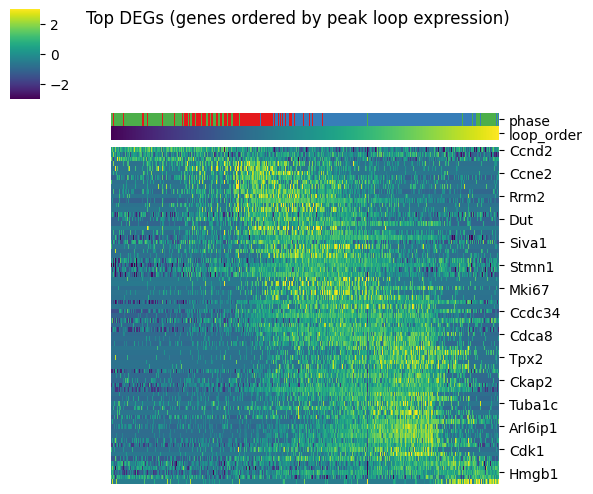

In [34]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Extract top N DEGs per leiden cluster
degs_df = sc.get.rank_genes_groups_df(adata_subset_loop, group=None)
top_n = 20
top_genes = (
    degs_df
    .groupby("group")
    .apply(lambda x: x.nsmallest(top_n, "pvals_adj"))
    .reset_index(drop=True)["names"]
    .unique()
    .tolist()
)
print(f"{len(top_genes)} top DEGs extracted across leiden_loop_clusters.")

# Step 2: Subset AnnData and compute z-score
adata_degs = adata_subset_loop[:, top_genes].copy()
X = adata_degs.X.toarray() if hasattr(adata_degs.X, "toarray") else adata_degs.X
adata_degs.layers["zscore"] = zscore(X, axis=0)

# Step 3: Order cells
# # Based on loop_order
adata_degs.obs["sort_key"] = adata_degs.obs["loop_order"]

adata_degs = adata_degs[adata_degs.obs.sort_values("sort_key").index].copy()

# Step 4: Use predefined peak-sorting function on zscore matrix
# Prepare adata_degs.obsm["zscore"] for function input
adata_degs.obsm["zscore"] = adata_degs.layers["zscore"]
loop_path = np.argsort(adata_degs.obs["loop_order"].values)

sorted_data, _, _, sorted_columns = ccd.ul.sort_and_smooth_signal_along_path(
    adata_degs,
    signal_key="zscore",
    path=loop_path,
    sigma=2
)

# Step 5: Reorder genes in AnnData object
adata_degs = adata_degs[:, sorted_columns].copy()

# Step 6: Plot
with plt.rc_context(rc=custom_rc):
    ccd.pl.heatmap_with_annotations(
        adata=adata_degs,
        val="zscore",
        transpose=True,
        obs_keys=['phase', 'loop_order'],
        pal=pal,
        use_clustermap=True,
        cluster_rows=False,
        cluster_cols=False,
        yticklabels='auto',
        cmap=sns.color_palette("viridis", as_cmap=True),
        row_scale=False,
        clip_limits=(-3, 3),
        rasterize=True,
        title="Top DEGs (genes ordered by peak loop expression)",
        figsize=(6, 5),
        title_fontsize=12,
        save_path=save_dir / f"{proj_name}_{cell_type_subset}_top_degs_heatmap.svg",
        show=True
    )

In [32]:
# save the genes into a file
with open(save_dir / f"{proj_name}_{cell_type_subset}_top_degs.txt", "w") as f:
    f.write("\n".join(top_genes))
print(f"Top DEGs saved to {save_dir / f'{proj_name}_{cell_type_subset}_top_degs.txt'}")


Top DEGs saved to ../save/gut_dev_Huycke-Aug08-0055/gut_dev_Huycke_Smooth muscle_top_degs.txt


In [33]:
# save the adata to the same h5ad file
adata_subset_loop.write_h5ad(save_dir / f"{file_name}_{cell_type_subset}_loop.h5ad")